## YOLO-V3 Implementation

### Importing Libraries

In [31]:
import os
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
import scipy.io
import scipy.misc
import numpy as np
import cv2
import PIL
import struct
from numpy import expand_dims
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
from matplotlib.patches import Rectangle

In [0]:
import tensorflow as tf
from skimage.transform import resize
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, Conv2D, BatchNormalization, LeakyReLU, ZeroPadding2D, UpSampling2D
from tensorflow.keras.models import load_model, Model
from tensorflow.keras.layers import add, concatenate
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array

### Loading and Building the Yolo-v3 Model

In [0]:
class WeightReader:
    def __init__(self, weight_file):
        with open(weight_file, 'rb') as w_f:
            major,    = struct.unpack('i', w_f.read(4))
            minor,    = struct.unpack('i', w_f.read(4))
            revision, = struct.unpack('i', w_f.read(4))

            if (major*10 + minor) >= 2 and major < 1000 and minor < 1000:
                w_f.read(8)
            else:
                w_f.read(4)

            transpose = (major > 1000) or (minor > 1000)
            
            binary = w_f.read()

        self.offset = 0
        self.all_weights = np.frombuffer(binary, dtype='float32')
        
    def read_bytes(self, size):
        self.offset = self.offset + size
        return self.all_weights[self.offset-size:self.offset]

    def load_weights(self, model):
        for i in range(106):
            try:
                conv_layer = model.get_layer('conv_' + str(i))
                print("loading weights of convolution #" + str(i))

                if i not in [81, 93, 105]:
                    norm_layer = model.get_layer('bnorm_' + str(i))

                    size = np.prod(norm_layer.get_weights()[0].shape)

                    beta  = self.read_bytes(size) # bias
                    gamma = self.read_bytes(size) # scale
                    mean  = self.read_bytes(size) # mean
                    var   = self.read_bytes(size) # variance            

                    weights = norm_layer.set_weights([gamma, beta, mean, var])  

                if len(conv_layer.get_weights()) > 1:
                    bias   = self.read_bytes(np.prod(conv_layer.get_weights()[1].shape))
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2,3,1,0])
                    conv_layer.set_weights([kernel, bias])
                else:
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2,3,1,0])
                    conv_layer.set_weights([kernel])
            except ValueError:
                print("no convolution #" + str(i))     
    
    def reset(self):
        self.offset = 0

In [0]:
def _conv_block(inp, convs, skip=True):
    x = inp
    count = 0
    
    for conv in convs:
        if count == (len(convs) - 2) and skip:
            skip_connection = x
        count += 1
        
        if conv['stride'] > 1: x = ZeroPadding2D(((1,0),(1,0)))(x) # peculiar padding as darknet prefer left and top
        x = Conv2D(conv['filter'], 
                   conv['kernel'], 
                   strides=conv['stride'], 
                   padding='valid' if conv['stride'] > 1 else 'same', # peculiar padding as darknet prefer left and top
                   name='conv_' + str(conv['layer_idx']), 
                   use_bias=False if conv['bnorm'] else True)(x)
        if conv['bnorm']: x = BatchNormalization(epsilon=0.001, name='bnorm_' + str(conv['layer_idx']))(x)
        if conv['leaky']: x = LeakyReLU(alpha=0.1, name='leaky_' + str(conv['layer_idx']))(x)

    return add([skip_connection, x]) if skip else x

In [0]:
# creating the YOLO model
def make_yolov3_model():
    input_image = Input(shape=(None, None, 3))

    # Layer  0 => 4
    x = _conv_block(input_image, [{'filter': 32, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 0},
                                  {'filter': 64, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 1},
                                  {'filter': 32, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 2},
                                  {'filter': 64, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 3}])

    # Layer  5 => 8
    x = _conv_block(x, [{'filter': 128, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 5},
                        {'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 6},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 7}])

    # Layer  9 => 11
    x = _conv_block(x, [{'filter':  64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 9},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 10}])

    # Layer 12 => 15
    x = _conv_block(x, [{'filter': 256, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 12},
                        {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 13},
                        {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 14}])

    # Layer 16 => 36
    for i in range(7):
        x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 16+i*3},
                            {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 17+i*3}])
        
    skip_36 = x
        
    # Layer 37 => 40
    x = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 37},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 38},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 39}])

    # Layer 41 => 61
    for i in range(7):
        x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 41+i*3},
                            {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 42+i*3}])
        
    skip_61 = x
        
    # Layer 62 => 65
    x = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 62},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 63},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 64}])

    # Layer 66 => 74
    for i in range(3):
        x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 66+i*3},
                            {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 67+i*3}])
        
    # Layer 75 => 79
    x = _conv_block(x, [{'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 75},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 76},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 77},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 78},
                        {'filter':  512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 79}], skip=False)

    # Layer 80 => 82
    yolo_82 = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 80},
                              {'filter':  255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 81}], skip=False)

    # Layer 83 => 86
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 84}], skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_61])

    # Layer 87 => 91
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 87},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 88},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 89},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 90},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 91}], skip=False)

    # Layer 92 => 94
    yolo_94 = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 92},
                              {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 93}], skip=False)

    # Layer 95 => 98
    x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True,   'layer_idx': 96}], skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_36])

    # Layer 99 => 106
    yolo_106 = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 99},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 100},
                               {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 101},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 102},
                               {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 103},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True,  'leaky': True,  'layer_idx': 104},
                               {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False, 'layer_idx': 105}], skip=False)

    model = Model(input_image, [yolo_82, yolo_94, yolo_106])    
    return model

In [37]:
net_h, net_w = 416, 416
obj_thresh, nms_thresh = 0.5, 0.45
anchors = [[116,90,  156,198,  373,326],  [30,61, 62,45,  59,119], [10,13,  16,30,  33,23]]
labels = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck", \
              "boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench", \
              "bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe", \
              "backpack", "umbrella", "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard", \
              "sports ball", "kite", "baseball bat", "baseball glove", "skateboard", "surfboard", \
              "tennis racket", "bottle", "wine glass", "cup", "fork", "knife", "spoon", "bowl", "banana", \
              "apple", "sandwich", "orange", "broccoli", "carrot", "hot dog", "pizza", "donut", "cake", \
              "chair", "sofa", "pottedplant", "bed", "diningtable", "toilet", "tvmonitor", "laptop", "mouse", \
              "remote", "keyboard", "cell phone", "microwave", "oven", "toaster", "sink", "refrigerator", \
              "book", "clock", "vase", "scissors", "teddy bear", "hair drier", "toothbrush"]

# make the yolov3 model to predict 80 classes on COCO

yolov3 = make_yolov3_model()

# load the weights trained on COCO into the model
weight_reader = WeightReader('/content/drive/My Drive/Colab Notebooks/ML/Vehicle Detection Project/yolov3.weights')
weight_reader.load_weights(yolov3)

# save the model to file
yolov3.save('/content/drive/My Drive/Colab Notebooks/ML/Vehicle Detection Project/yolov3.h5')

# load yolov3 model
yolov3 = load_model('/content/drive/My Drive/Colab Notebooks/ML/Vehicle Detection Project/yolov3.h5')

loading weights of convolution #0
loading weights of convolution #1
loading weights of convolution #2
loading weights of convolution #3
no convolution #4
loading weights of convolution #5
loading weights of convolution #6
loading weights of convolution #7
no convolution #8
loading weights of convolution #9
loading weights of convolution #10
no convolution #11
loading weights of convolution #12
loading weights of convolution #13
loading weights of convolution #14
no convolution #15
loading weights of convolution #16
loading weights of convolution #17
no convolution #18
loading weights of convolution #19
loading weights of convolution #20
no convolution #21
loading weights of convolution #22
loading weights of convolution #23
no convolution #24
loading weights of convolution #25
loading weights of convolution #26
no convolution #27
loading weights of convolution #28
loading weights of convolution #29
no convolution #30
loading weights of convolution #31
loading weights of convolution #32

In [0]:
from numpy import expand_dims
def load_image_pixels(filename, shape):
    # load the image to get its shape
    image = load_img(filename)
    width, height = image.size
    # load the image with the required size
    image = load_img(filename, target_size=shape)
    # convert to numpy array
    image = img_to_array(image)
    # scale pixel values to [0, 1]
    image = image.astype('float32')
    image /= 255.0
    # add a dimension so that we have one sample
    image = expand_dims(image, 0)
    return image, width, height

In [0]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/drive/My Drive/Colab Notebooks/ML/Vehicle Detection Project/car.jpeg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))

In [0]:
class BoundBox:
    def __init__(self, xmin, ymin, xmax, ymax, objness = None, classes = None):
        self.xmin = xmin
        self.ymin = ymin
        self.xmax = xmax
        self.ymax = ymax
        
        self.objness = objness
        self.classes = classes

        self.label = -1
        self.score = -1

    def get_label(self):
        if self.label == -1:
            self.label = np.argmax(self.classes)
        
        return self.label
    
    def get_score(self):
        if self.score == -1:
            self.score = self.classes[self.get_label()]
            
        return self.score

def _sigmoid(x):
    return 1. / (1. + np.exp(-x))

def _interval_overlap(interval_a, interval_b):
    x1, x2 = interval_a
    x3, x4 = interval_b

    if x3 < x1:
        if x4 < x1:
            return 0
        else:
            return min(x2,x4) - x1
    else:
        if x2 < x3:
             return 0
        else:
            return min(x2,x4) - x3 
def bbox_iou(box1, box2):
    intersect_w = _interval_overlap([box1.xmin, box1.xmax], [box2.xmin, box2.xmax])
    intersect_h = _interval_overlap([box1.ymin, box1.ymax], [box2.ymin, box2.ymax])
    
    intersect = intersect_w * intersect_h

    w1, h1 = box1.xmax-box1.xmin, box1.ymax-box1.ymin
    w2, h2 = box2.xmax-box2.xmin, box2.ymax-box2.ymin
    
    union = w1*h1 + w2*h2 - intersect
    
    return float(intersect) / union

def do_nms(boxes, nms_thresh):
    if len(boxes) > 0:
        nb_class = len(boxes[0].classes)
    else:
        return
        
    for c in range(nb_class):
        sorted_indices = np.argsort([-box.classes[c] for box in boxes])

        for i in range(len(sorted_indices)):
            index_i = sorted_indices[i]

            if boxes[index_i].classes[c] == 0: continue

            for j in range(i+1, len(sorted_indices)):
                index_j = sorted_indices[j]

                if bbox_iou(boxes[index_i], boxes[index_j]) >= nms_thresh:
                    boxes[index_j].classes[c] = 0

In [0]:
#decode_netout() that will take each one of the NumPy arrays, one at a time, 
#and decode the candidate bounding boxes and class predictions
def decode_netout(netout, anchors, obj_thresh,  net_h, net_w):
    grid_h, grid_w = netout.shape[:2]
    nb_box = 3
    netout = netout.reshape((grid_h, grid_w, nb_box, -1))
    nb_class = netout.shape[-1] - 5

    boxes = []

    netout[..., :2]  = _sigmoid(netout[..., :2])
    netout[..., 4:]  = _sigmoid(netout[..., 4:])
    netout[..., 5:]  = netout[..., 4][..., np.newaxis] * netout[..., 5:]
    netout[..., 5:] *= netout[..., 5:] > obj_thresh

    for i in range(grid_h*grid_w):
        row = i / grid_w
        col = i % grid_w
        
        for b in range(nb_box):
            # 4th element is objectness score
            objectness = netout[int(row)][int(col)][b][4]
            #objectness = netout[..., :4]
            
            if(objectness.all() <= obj_thresh): continue
            
            # first 4 elements are x, y, w, and h
            x, y, w, h = netout[int(row)][int(col)][b][:4]

            x = (col + x) / grid_w # center position, unit: image width
            y = (row + y) / grid_h # center position, unit: image height
            w = anchors[2 * b + 0] * np.exp(w) / net_w # unit: image width
            h = anchors[2 * b + 1] * np.exp(h) / net_h # unit: image height  
            
            # last elements are class probabilities
            classes = netout[int(row)][col][b][5:]
            
            box = BoundBox(x-w/2, y-h/2, x+w/2, y+h/2, objectness, classes)
            #box = BoundBox(x-w/2, y-h/2, x+w/2, y+h/2, None, classes)

            boxes.append(box)

    return boxes

In [0]:
# bounding boxes will be stretched back into the shape of the original image
#will allow plotting the original image and draw the bounding boxes, hopefully detecting real objects.
# correct the sizes of the bounding boxes for the shape of the image
#correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
def correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w):
    if (float(net_w)/image_w) < (float(net_h)/image_h):
        new_w = net_w
        new_h = (image_h*net_w)/image_w
    else:
        new_h = net_w
        new_w = (image_w*net_h)/image_h
        
    for i in range(len(boxes)):
        x_offset, x_scale = (net_w - new_w)/2./net_w, float(new_w)/net_w
        y_offset, y_scale = (net_h - new_h)/2./net_h, float(new_h)/net_h
        
        boxes[i].xmin = int((boxes[i].xmin - x_offset) / x_scale * image_w)
        boxes[i].xmax = int((boxes[i].xmax - x_offset) / x_scale * image_w)
        boxes[i].ymin = int((boxes[i].ymin - y_offset) / y_scale * image_h)
        boxes[i].ymax = int((boxes[i].ymax - y_offset) / y_scale * image_h)

In [0]:
from matplotlib.patches import Rectangle
def draw_boxes(filename, v_boxes, v_labels, v_scores):
    # load the image
    data = plt.imread(filename)
    print(data.shape)
    # plot the image
    plt.imshow(data)
    # get the context for drawing boxes
    ax = plt.gca()
    # plot each box
    for i in range(len(v_boxes)):
        box = v_boxes[i]
        # get coordinates
        y1, x1, y2, x2 = box.ymin, box.xmin, box.ymax, box.xmax
        # calculate width and height of the box
        width, height = x2 - x1, y2 - y1
        # create the shape
        rect = Rectangle((x1, y1), width, height, fill=False, color='red')
        # draw the box
        ax.add_patch(rect)
        # draw text and score in top left corner
        label = "%s (%.3f)" % (v_labels[i], v_scores[i])
        plt.text(x1, y1, label, color='red')
    # show the plot
    plt.show()

In [0]:
# get all of the results above a threshold
# takes the list of boxes, known labels, 
#and our classification threshold as arguments and returns parallel lists of boxes, labels, and scores.
def get_boxes(boxes, labels, thresh):
    v_boxes, v_labels, v_scores = list(), list(), list()
    # enumerate all boxes
    for box in boxes:
        # enumerate all possible labels
        for i in range(len(labels)):
            # check if the threshold for this label is high enough
            if box.classes[i] > thresh:
                v_boxes.append(box)
                v_labels.append(labels[i])
                v_scores.append(box.classes[i]*100)
                # don't break, many labels may trigger for one box
    return v_boxes, v_labels, v_scores

(1, 416, 416, 3) 168 300
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 69.44503784179688
truck 82.7565610408783
(168, 300, 3)


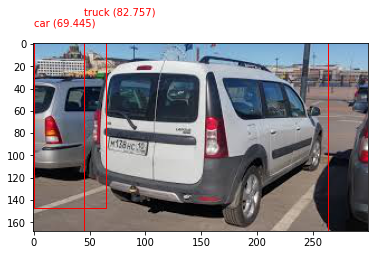

In [19]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/drive/My Drive/Colab Notebooks/ML/Vehicle Detection Project/car.jpeg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (net_w, net_w))
print(image.shape, image_h, image_w)

# make prediction
yolos = yolov3.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yolos])

# define the anchors
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()

for i in range(len(yolos)):
        # decode the output of the network
    boxes += decode_netout(yolos[i][0], anchors[i], obj_thresh,  net_h, net_w)

    # correct the sizes of the bounding boxes
correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w)

# suppress non-maximal boxes
do_nms(boxes, nms_thresh)

# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
    print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 64.3144428730011
car 92.10911989212036


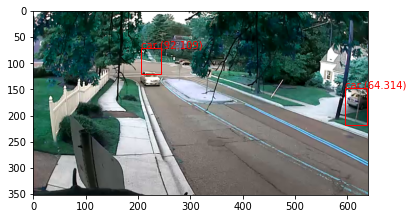

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 65.19349217414856
car 90.8579409122467


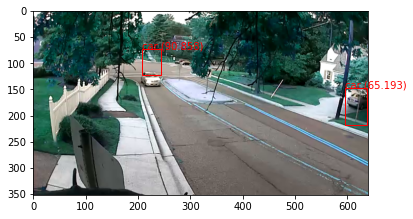

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 65.58455228805542
car 82.09542036056519


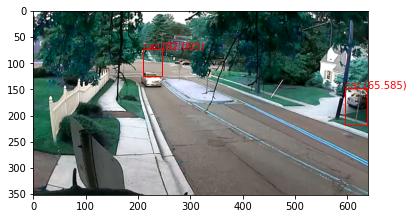

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 66.03258848190308
car 70.95513343811035


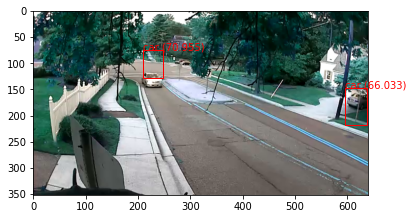

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 66.13629460334778
car 75.35365223884583


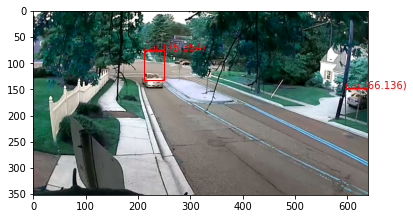

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 65.38574695587158
car 73.84541630744934


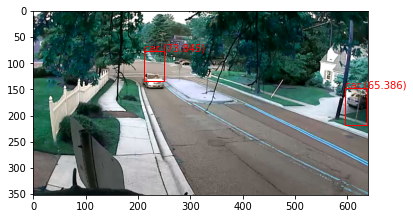

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 64.93321061134338
car 76.20487213134766


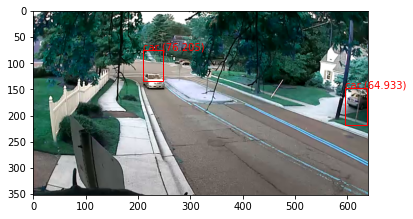

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 66.68720841407776
car 58.379244804382324


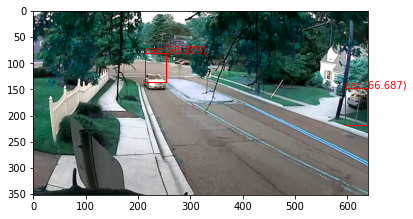

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 66.79885983467102
car 83.82793068885803


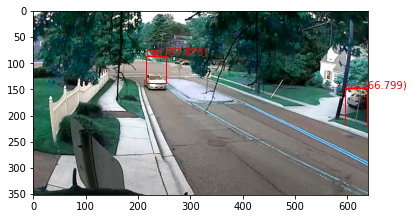

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 66.73972606658936
car 83.98023843765259


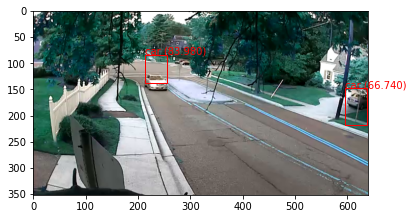

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 78.0275046825409
car 65.43936729431152


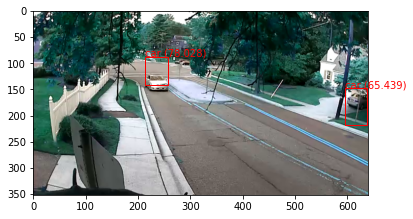

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 70.77080607414246
car 65.71086049079895


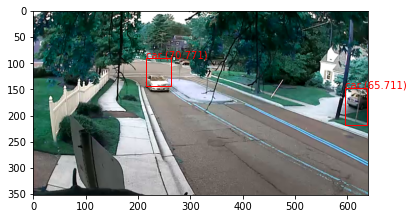

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 59.14158225059509
car 65.37888050079346


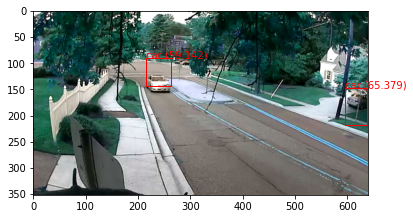

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.04053068161011
car 64.97332453727722


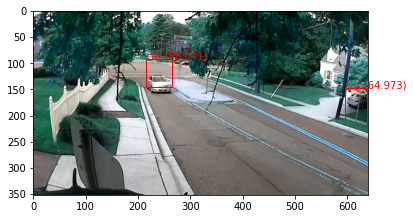

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.23274970054626
car 65.81504940986633


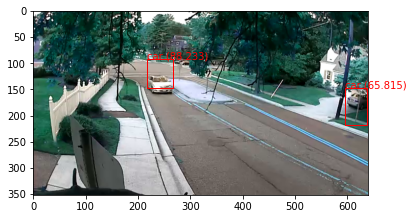

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 86.56808137893677
car 67.38424301147461


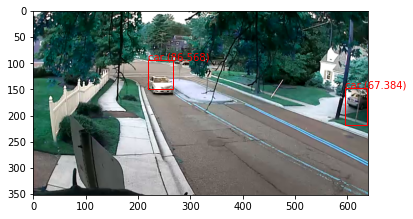

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 76.59666538238525
car 67.6763653755188


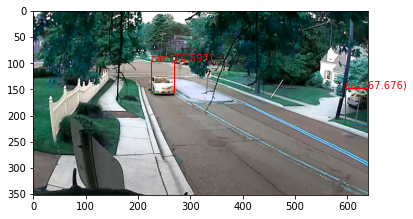

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.68882060050964
car 64.55780863761902


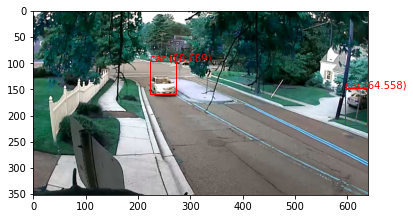

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.31532335281372
car 64.06511068344116


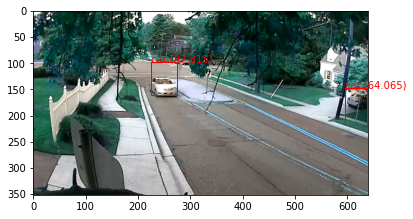

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.34143114089966
car 72.42271304130554


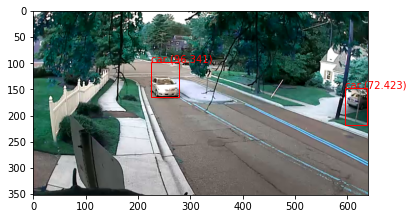

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.72935605049133
car 71.71722650527954


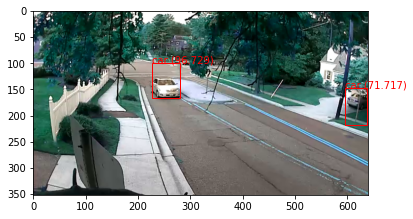

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.01448464393616
car 72.18077182769775


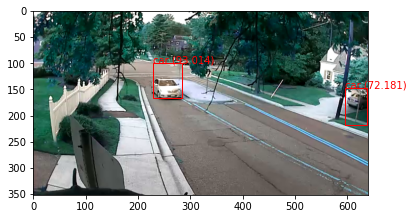

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.75237917900085
car 72.56803512573242


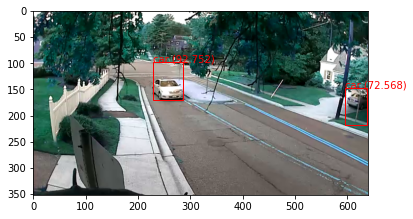

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.26179933547974
car 70.30367851257324


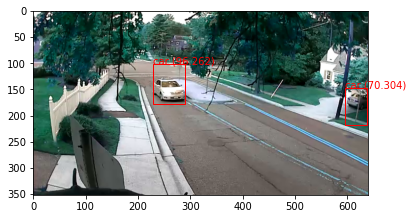

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.17679214477539
car 68.99734735488892


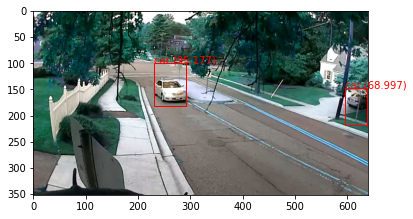

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.27254319190979
car 69.23114061355591


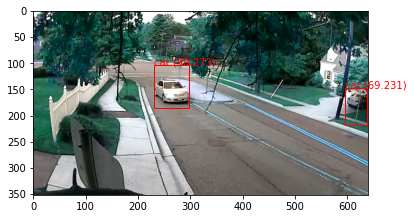

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.25835132598877
car 66.5163516998291


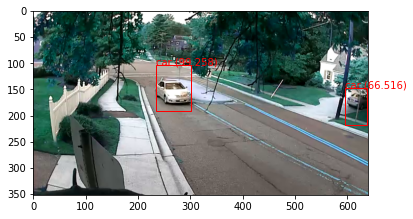

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.21392798423767
car 66.61067008972168


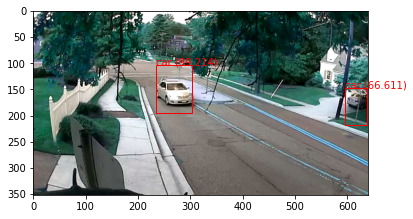

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.81031513214111
car 66.93333387374878


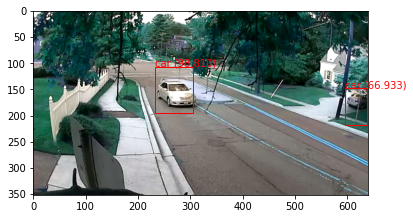

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.65989780426025
car 66.61241054534912


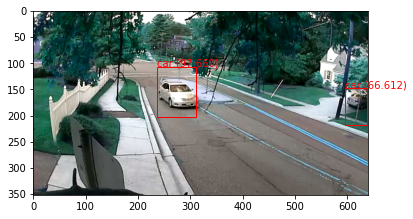

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.42484593391418
car 65.90263247489929
car 50.3665566444397


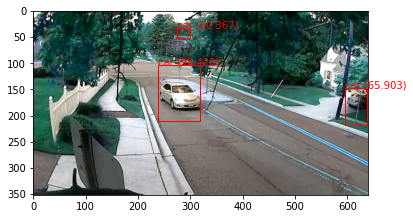

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.2943525314331
car 66.77020788192749
car 50.77626705169678


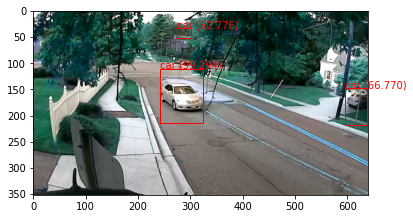

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.18583631515503
car 66.27421975135803
car 50.27270317077637


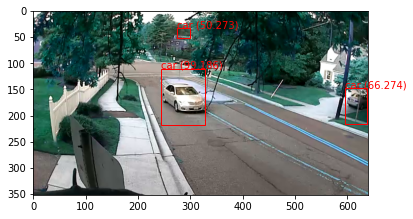

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.92172813415527
car 67.11066961288452
car 52.321141958236694


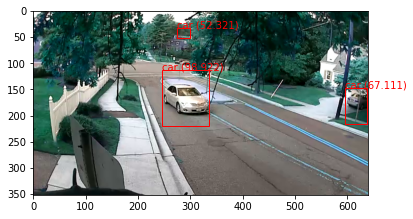

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.51726984977722
car 66.32779240608215
car 53.813183307647705


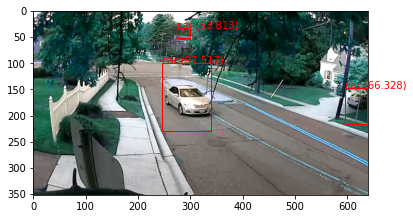

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.75370955467224
car 67.13886857032776


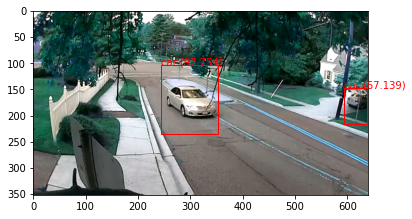

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.63130450248718
car 66.04582667350769
car 51.25541090965271


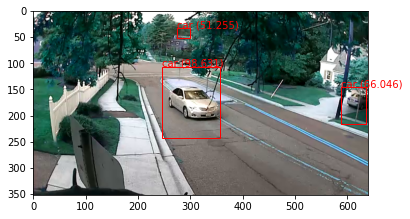

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.41561794281006
car 99.31655526161194


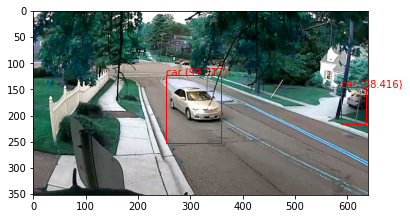

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.83034706115723
car 99.2193877696991


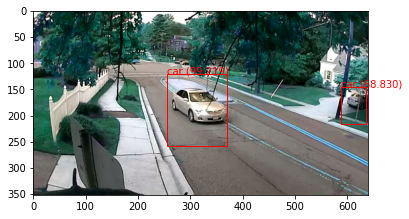

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 67.53882765769958
car 98.26573133468628


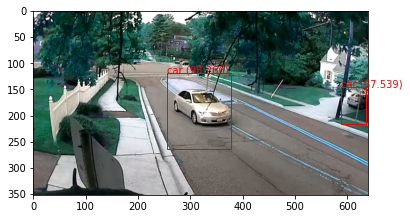

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.54035258293152
car 98.5058069229126


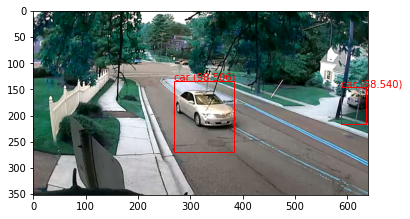

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.04917454719543
car 99.50822591781616


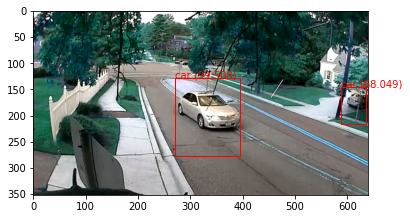

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 67.41564273834229
car 98.6886739730835


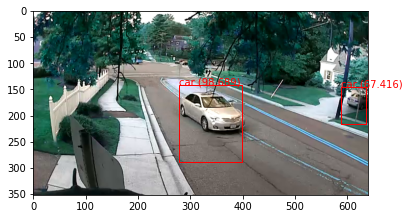

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 67.41410493850708
car 99.190354347229


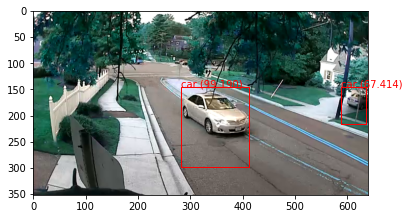

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 67.05530881881714
car 99.04232621192932


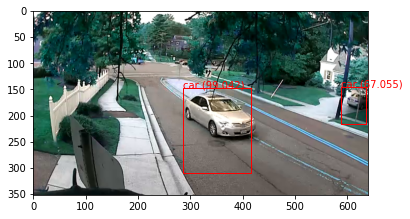

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.76899218559265
car 67.30039715766907


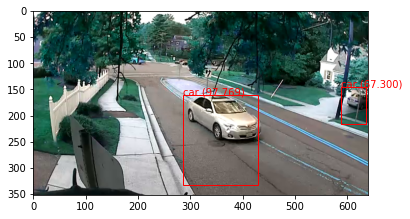

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.50872755050659
car 66.34037494659424


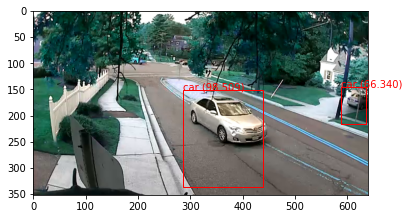

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.1550624370575
car 67.86515712738037


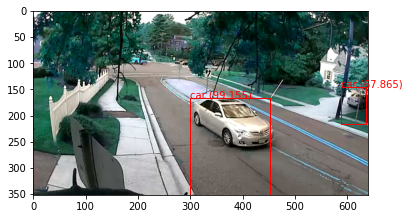

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.04428720474243


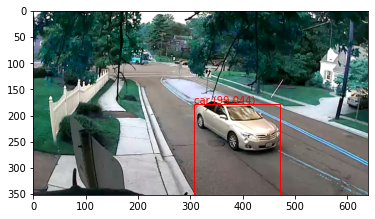

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.56591820716858


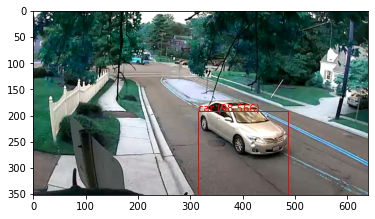

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.58180785179138
car 53.05997133255005


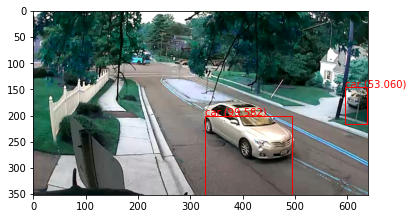

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.79609251022339
car 53.99124622344971


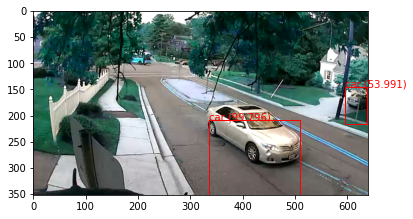

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.44894909858704
car 54.756855964660645


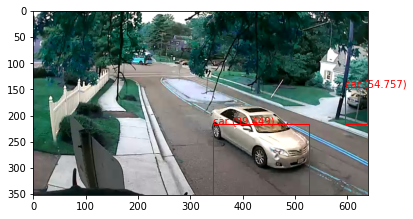

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.79873394966125


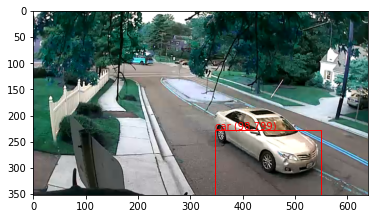

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.56720471382141
car 53.46330404281616
car 50.91514587402344


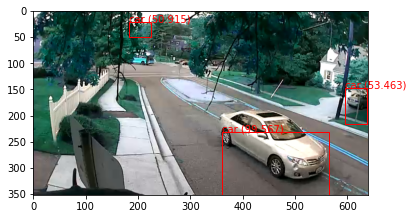

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.07122945785522
car 54.91495132446289


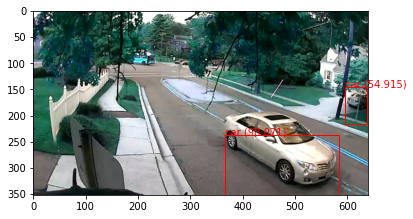

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.62242031097412
car 50.852370262145996


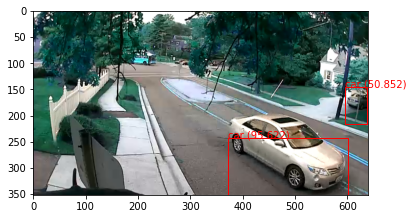

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.37307333946228
car 50.16050934791565
car 73.86138439178467


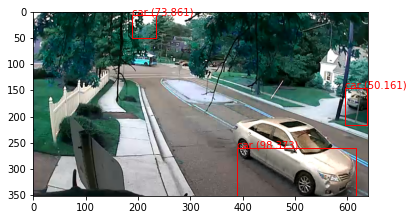

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.18230438232422
car 54.867130517959595
car 75.00840425491333


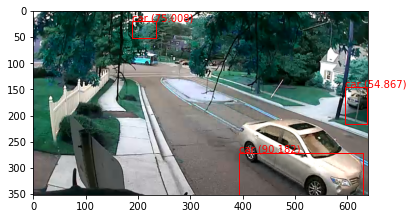

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 84.96774435043335
car 52.63424515724182
car 79.53518629074097


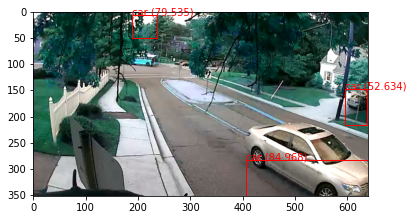

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 84.209144115448
car 50.00741481781006
car 81.51711225509644


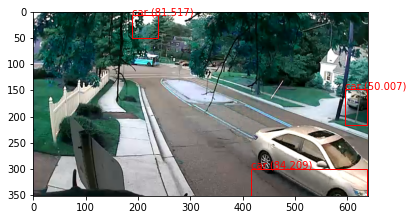

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.8032488822937
car 79.96777892112732


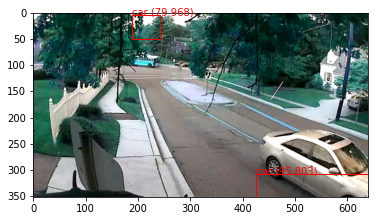

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.7439591884613
car 66.17878675460815


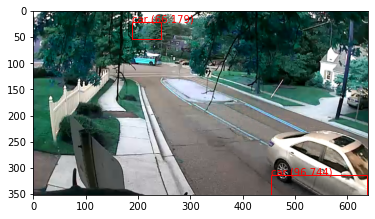

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.02488088607788


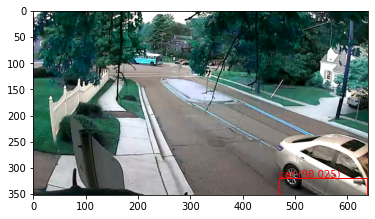

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.01419973373413
car 78.31718325614929


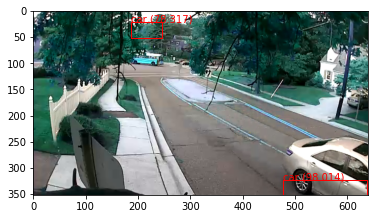

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 62.2829794883728
car 87.84085512161255


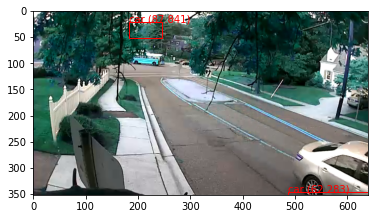

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.18200731277466
car 79.5497715473175


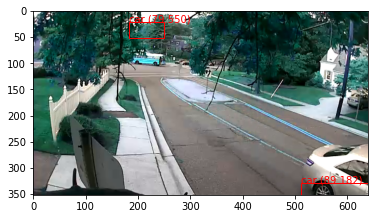

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.02568626403809


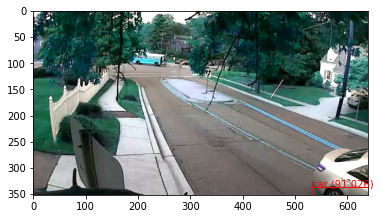

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.19776797294617
car 53.23394536972046


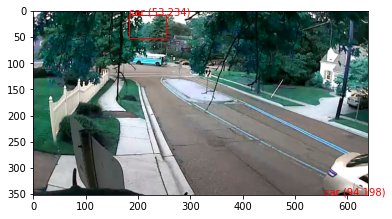

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


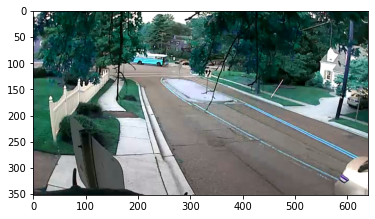

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 54.43045496940613


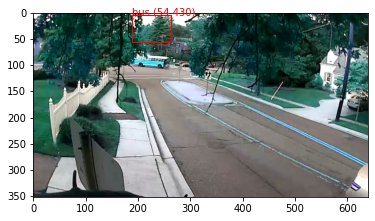

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 53.88196110725403


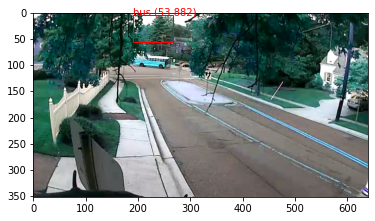

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 70.66009044647217


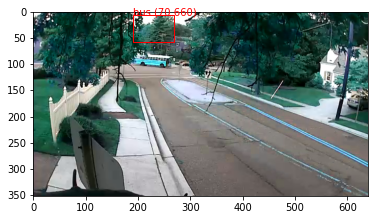

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 85.57661771774292


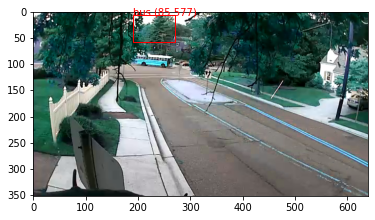

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 86.73834204673767


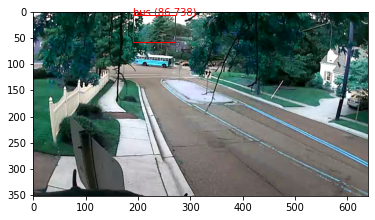

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 89.16112184524536


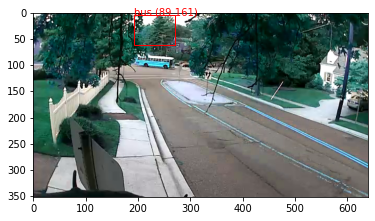

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 82.14552402496338


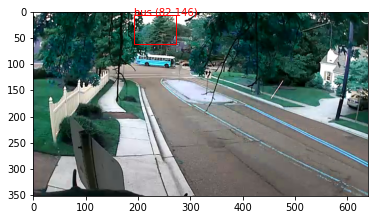

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 80.43314218521118


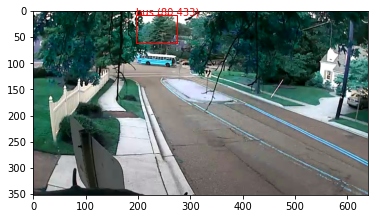

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 83.53036046028137


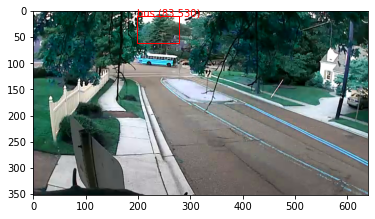

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 89.03157114982605


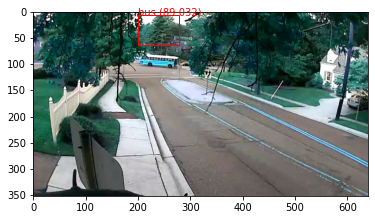

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 85.75690388679504


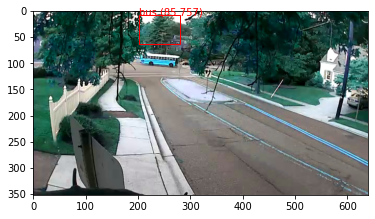

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 88.44763040542603


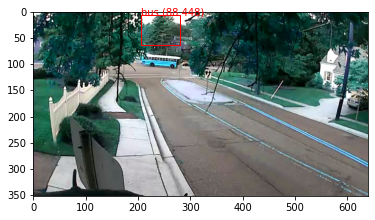

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 88.20889592170715


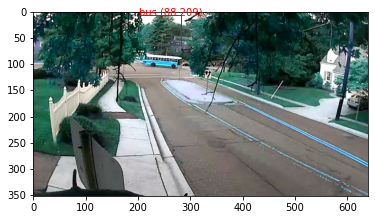

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 67.88408160209656


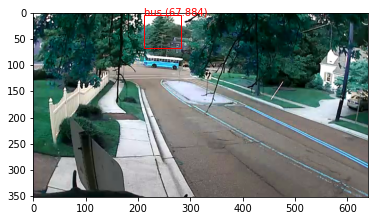

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 86.53296232223511


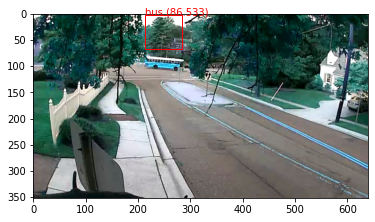

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 89.7717833518982


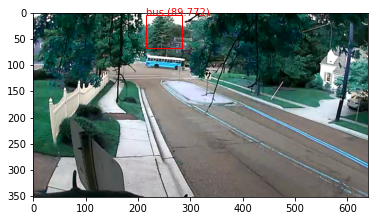

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 91.69149994850159


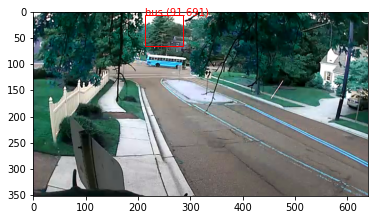

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 86.43251657485962


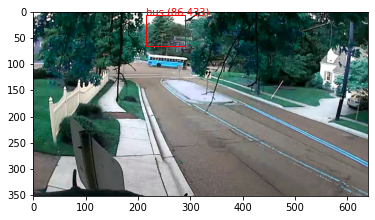

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 83.84581208229065


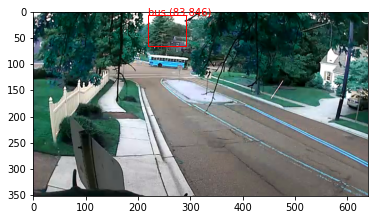

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 72.93581366539001


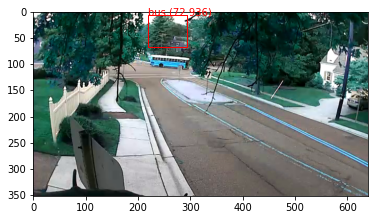

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 88.08141350746155


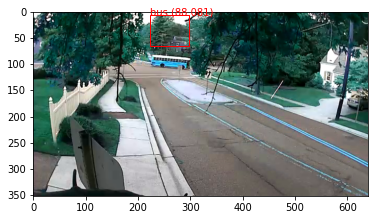

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 93.26516389846802


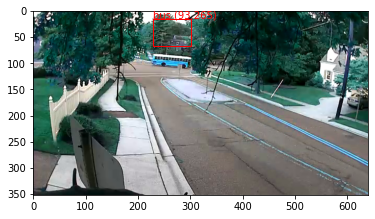

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 92.69871711730957


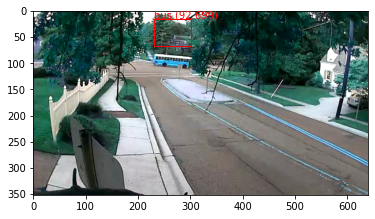

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 90.38850665092468


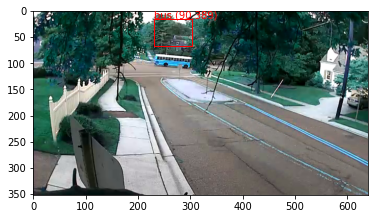

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 88.84156942367554


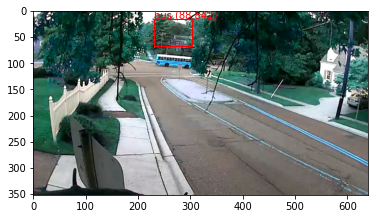

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
bus 89.95431065559387


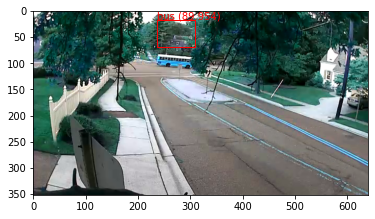

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.51955580711365
bus 89.11222219467163


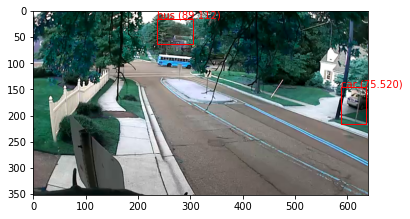

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.69612860679626
bus 89.4555389881134


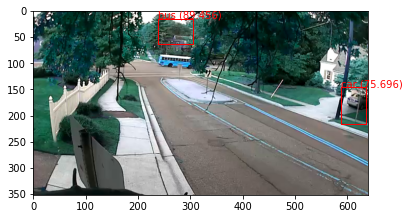

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.17948150634766
bus 81.51367902755737


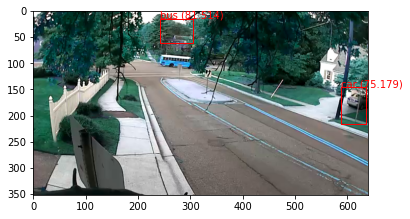

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.05815625190735
bus 89.45913314819336


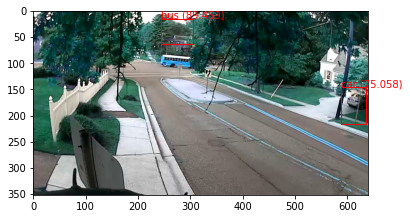

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.09316802024841
bus 94.838547706604


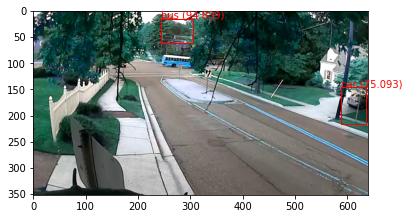

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.26437640190125
bus 96.00118398666382


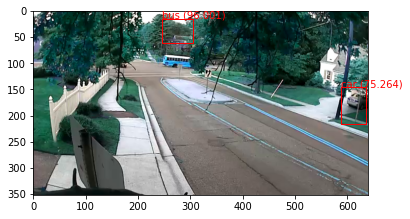

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.4166612625122
bus 91.35966300964355


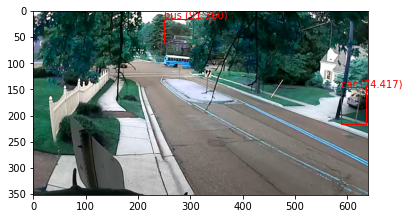

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.95740556716919
bus 89.43339586257935


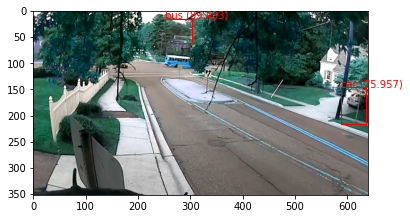

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.53165054321289
bus 75.34427642822266


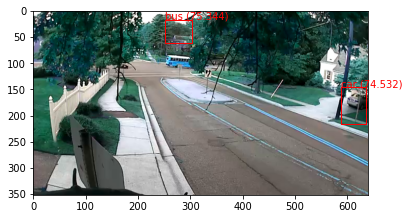

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.39475560188293
bus 71.10922336578369


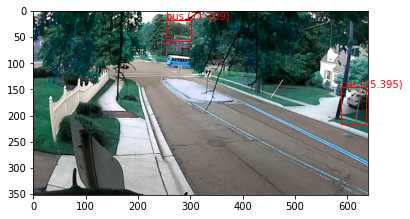

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.06684756278992
bus 62.95158267021179


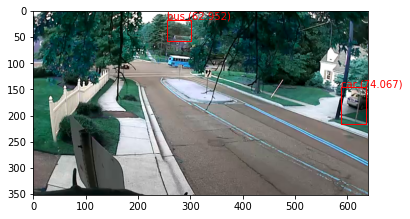

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.03401732444763
bus 71.22256755828857


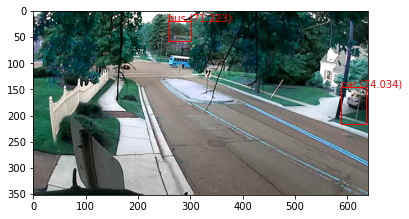

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.67682957649231


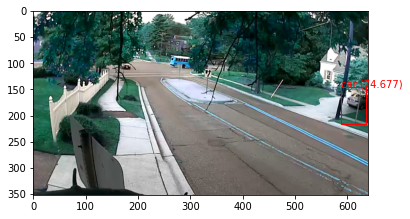

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.53797459602356


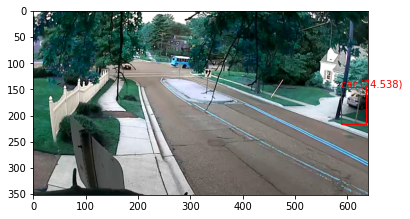

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.28001761436462


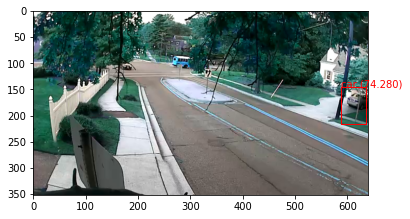

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.48468208312988


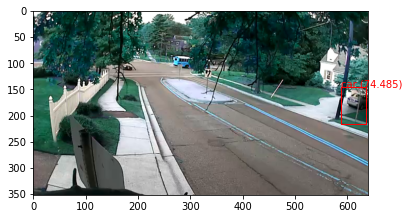

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.745112657547


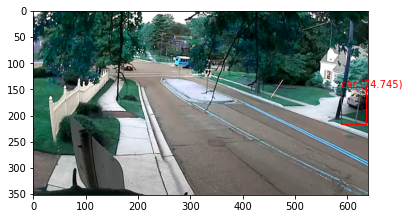

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.52930212020874


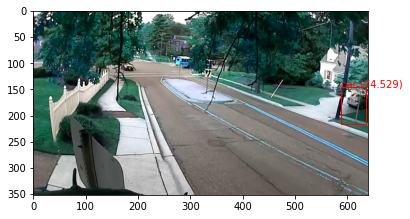

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.15398859977722
car 65.37807583808899


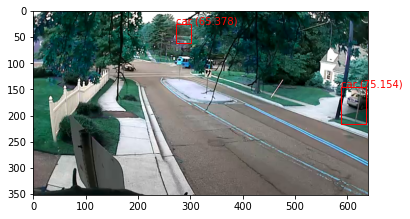

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.3239631652832
car 56.55505657196045


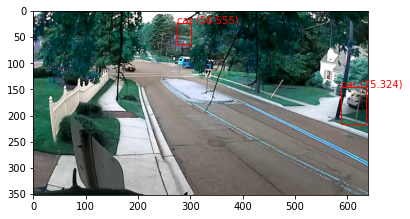

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.8324384689331
car 65.94151258468628


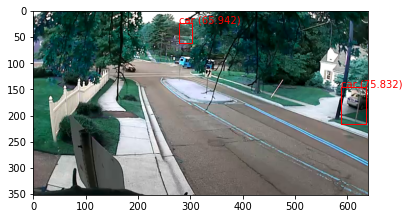

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.05704259872437
car 61.76655292510986


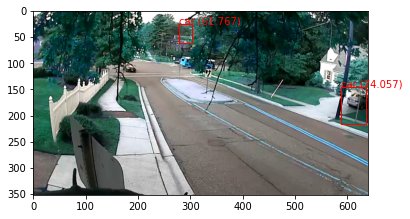

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 73.41645359992981
car 67.66515374183655


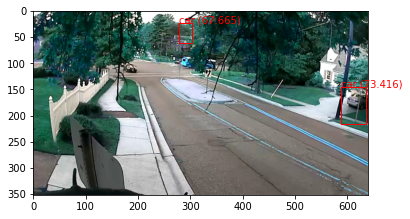

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.69977045059204
car 71.6282844543457
car 57.19664692878723


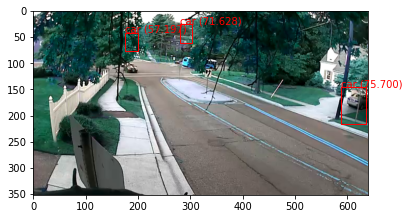

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.75674748420715


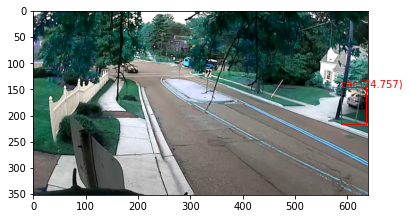

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.46597218513489


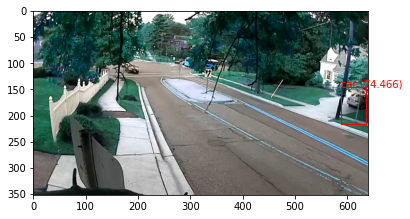

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.76630806922913


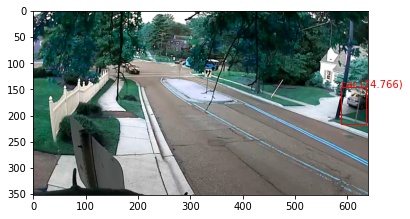

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.88852739334106
car 72.28060364723206


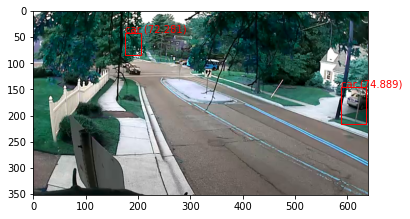

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.9022901058197
car 68.50817799568176


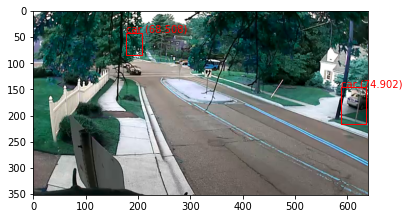

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 75.05587935447693
car 59.22200083732605


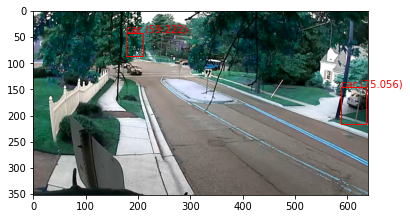

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.69737529754639
car 72.49836325645447


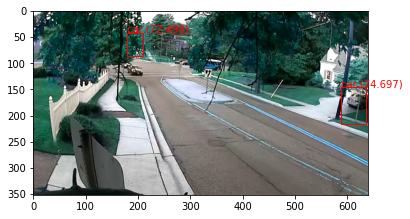

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.35035109519958
car 79.53165173530579


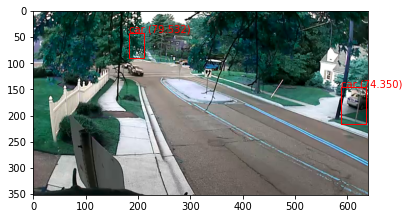

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.06372427940369
car 77.01306343078613


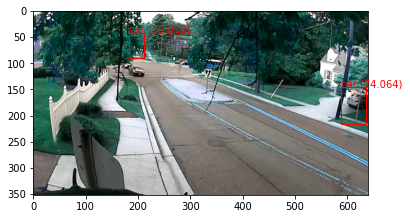

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 73.86534810066223
car 65.40098786354065


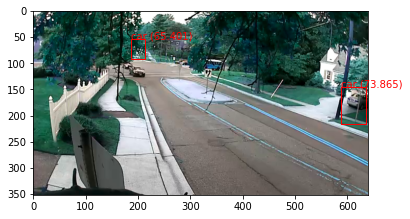

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 74.1648018360138
car 85.38341522216797


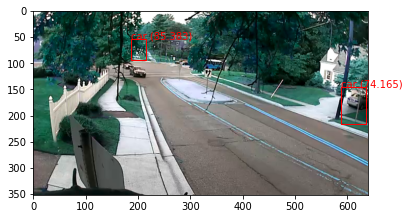

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.20629239082336
car 53.766560554504395
car 84.39056873321533


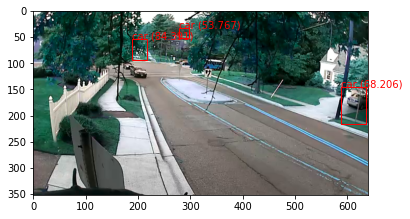

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 67.63968467712402
car 84.18304324150085


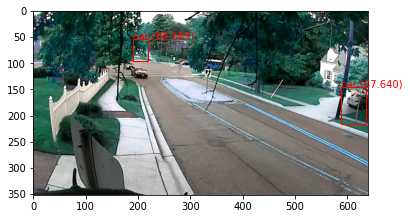

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 69.18724775314331
car 90.27122855186462


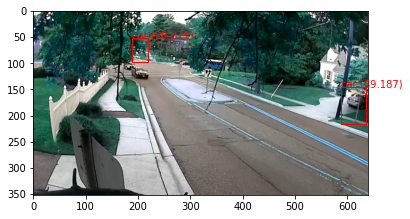

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 69.00055408477783
car 57.863789796829224
car 77.62154340744019


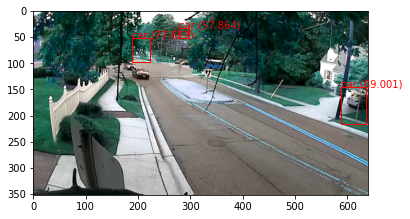

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.9341127872467
car 54.529380798339844
car 69.82039213180542


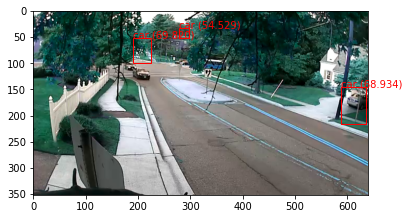

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.20098757743835
car 90.172278881073


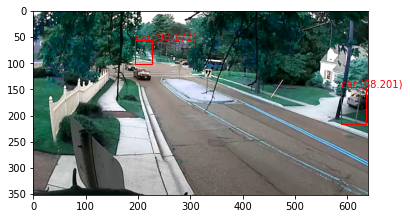

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.51269602775574
car 93.32838654518127


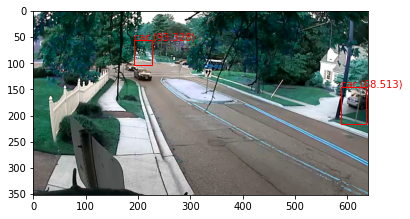

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 69.50550079345703
car 91.05713963508606


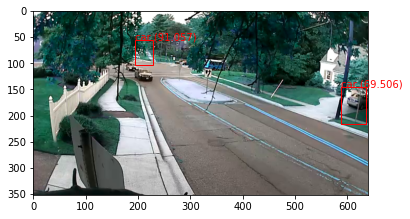

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.55377554893494
car 91.54938459396362


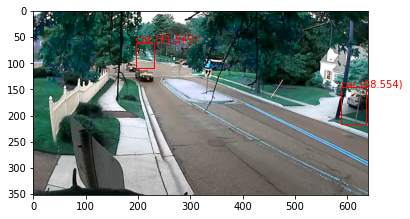

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 69.30960416793823
car 96.55718207359314


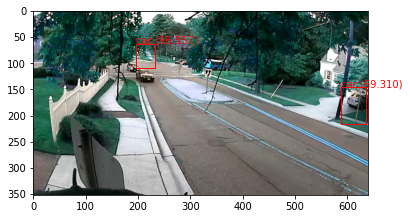

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 70.15526294708252
car 95.39018273353577


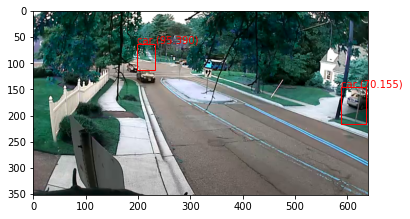

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 69.90650296211243
car 76.92688703536987
car 98.38334918022156


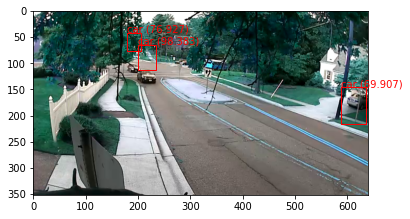

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 68.9523994922638
car 87.27450370788574
car 98.76453876495361


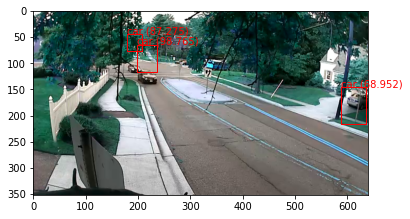

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.65348505973816
car 96.16454243659973


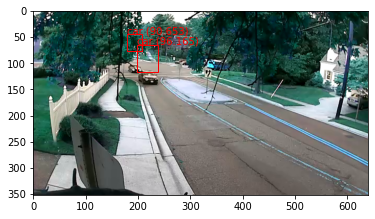

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 90.46014547348022
car 94.35354471206665


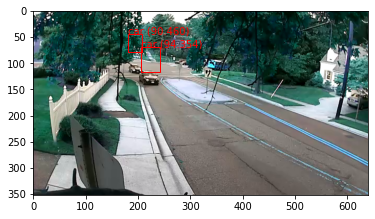

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.73526072502136
car 93.49493384361267


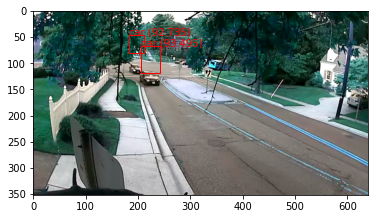

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.46293520927429
car 89.75576162338257


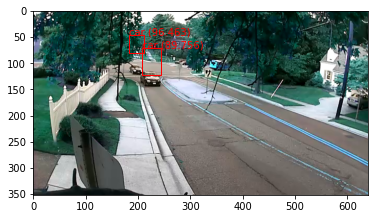

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.18497395515442
car 91.95038676261902


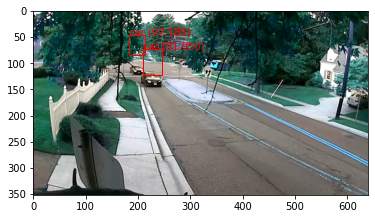

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 96.89733386039734
car 92.01754331588745


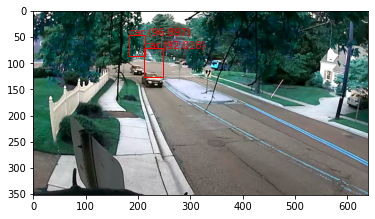

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.3573317527771
car 94.11365389823914


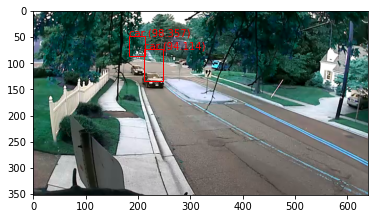

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.18576073646545
car 80.44486045837402


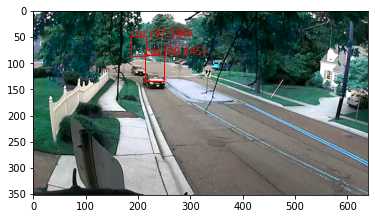

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.61657118797302
car 92.60231256484985


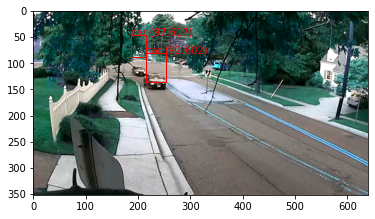

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.10575532913208
car 91.54996275901794


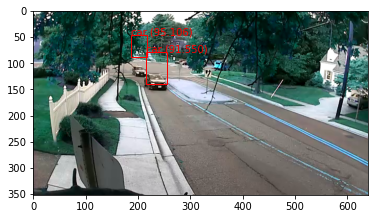

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 82.51299858093262
car 95.48096060752869


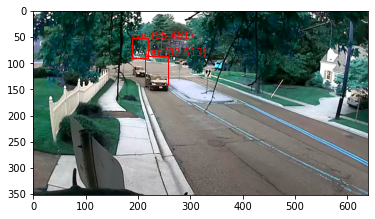

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.79818844795227
car 68.07445883750916


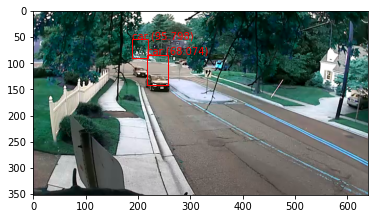

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 87.47130036354065
car 96.59695625305176


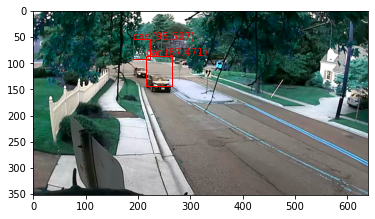

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.20314145088196
car 96.61814570426941


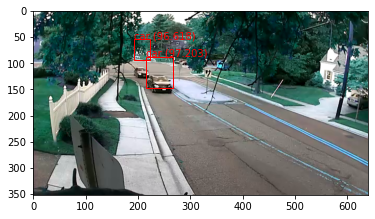

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.32913160324097
car 86.98890209197998


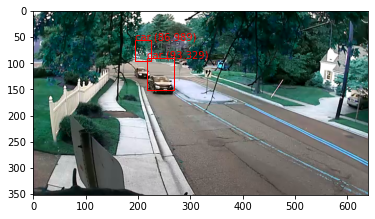

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 93.26294660568237
car 93.92595291137695


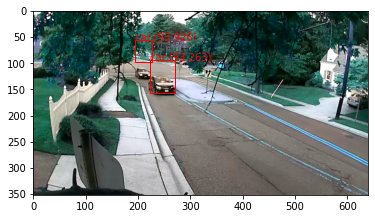

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.19468951225281
car 91.49802327156067


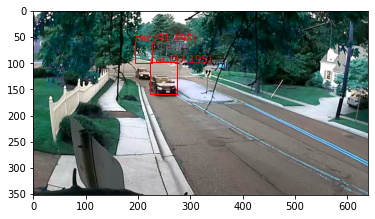

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 88.20409774780273
car 91.60867929458618


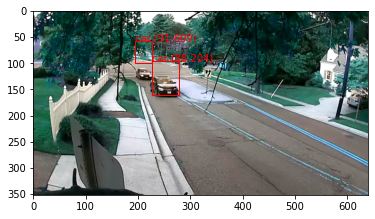

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 92.3003077507019
car 96.39555215835571


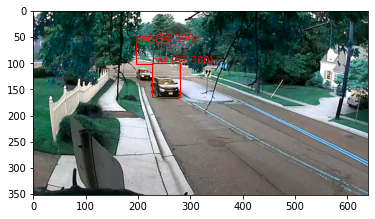

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.02014827728271
car 95.04038691520691


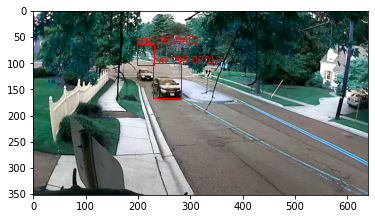

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.22371697425842
car 97.94268012046814


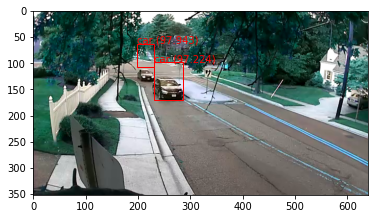

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.0609655380249
car 98.71093034744263


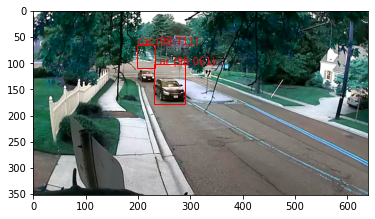

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 95.75228691101074
car 98.13180565834045


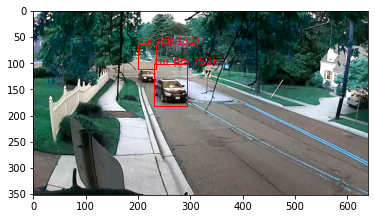

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.87728095054626
car 98.55399131774902


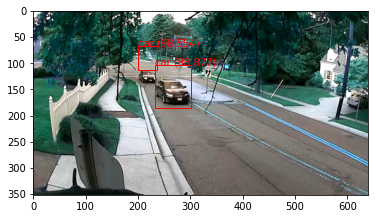

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.98433685302734
car 98.27991127967834


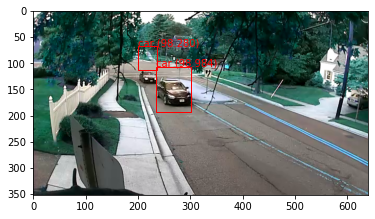

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.46224689483643
car 98.51927757263184


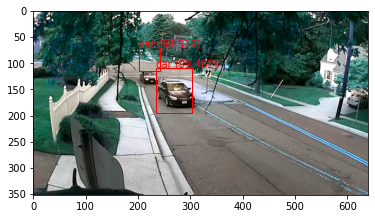

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 98.07059168815613
car 98.63287210464478


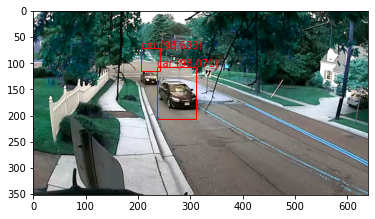

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 99.39104318618774
car 97.37412333488464


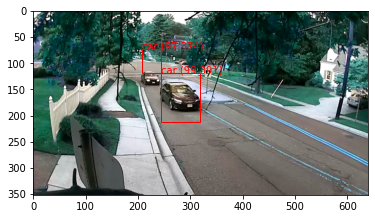

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 97.65626788139343
car 97.45272397994995


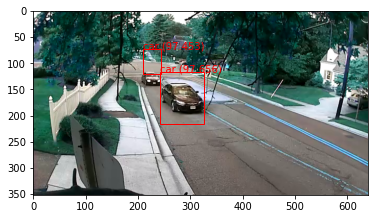

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.66402411460876
car 98.38881492614746


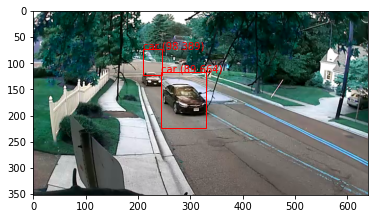

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 91.68380498886108
car 98.08290600776672


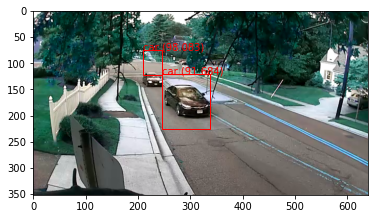

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 89.55545425415039
car 97.52973318099976


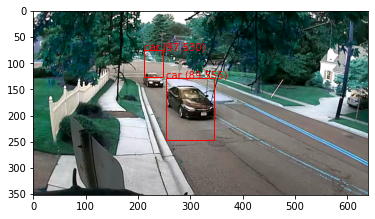

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
car 94.37229633331299


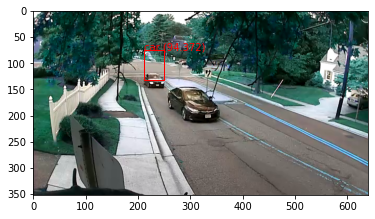

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
truck 67.54708290100098
car 83.3405613899231


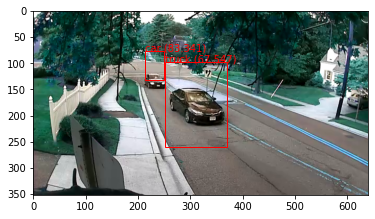

[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]


KeyboardInterrupt: ignored

In [49]:
cap = cv2.VideoCapture('/content/drive/My Drive/Colab Notebooks/ML/Vehicle Detection Project/sample.mp4')

while(True):
  
  ret, image_org = cap.read()
  
  image = cv2.resize(image_org, (416, 416))

  input_w, input_h = image_org.shape[:2]
  # convert to numpy array
  image = img_to_array(image)
  # scale pixel values to [0, 1]
  image = image.astype('float32')
  image /= 255.0
  # add a dimension so that we have one sample
  image = expand_dims(image, 0)

  # make prediction
  yolos = yolov3.predict(image)
  # summarize the shape of the list of arrays
  print([a.shape for a in yolos])

  # define the anchors
  anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
  # define the probability threshold for detected objects
  class_threshold = 0.2
  boxes = list()

  for i in range(len(yolos)):
          # decode the output of the network
      boxes += decode_netout(yolos[i][0], anchors[i], obj_thresh,  net_h, net_w)

      # correct the sizes of the bounding boxes
  correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w)

  # suppress non-maximal boxes
  do_nms(boxes, nms_thresh)

  # get the details of the detected objects
  v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
  # summarize what we found
  for i in range(len(v_boxes)):
      print(v_labels[i], v_scores[i])
  
  image = image.reshape((416, 416, 3))
  # plot the image
  plt.imshow(image_org)
  # get the context for drawing boxes
  ax = plt.gca()
  # plot each box
  for i in range(len(v_boxes)):
      box = v_boxes[i]
      # get coordinates
      y1, x1, y2, x2 = (box.ymin/168)*350, (box.xmin/300)*640, (box.ymax/168)*350, (box.xmax/300)*640
      # calculate width and height of the box
      width, height = x2 - x1, y2 - y1
      # create the shape
      rect = Rectangle((x1, y1), width, height, fill=False, color='red')
      # draw the box
      ax.add_patch(rect)
      # draw text and score in top left corner
      label = "%s (%.3f)" % (v_labels[i], v_scores[i])
      plt.text(x1, y1, label, color='red')
  # show the plot
  plt.show()

cap.release()
#out.release()
cv2.destroyAllWindows()
